In [1]:
import os
import sys
import time
import numpy as np
import pandas as pd
import gzip
import matplotlib.pyplot as plt
#import umap
import glob


import matplotlib.cm as cm
import matplotlib.colors as mcolors
import matplotlib.font_manager as font_manager
import seaborn as sns
import random
import math

In [2]:
os.chdir("/net/seq/data2/projects/aabisheva/Encode/my_ipynb/")

In [3]:
import sklearn
print(sklearn.__version__)

1.2.2


In [4]:
import sklearn.decomposition as skd
from sklearn.decomposition._nmf import _BaseNMF, _beta_loss_to_float, _initialize_nmf, _beta_divergence, _fit_coordinate_descent

In [5]:
from abc import ABC
from numbers import Integral, Real
import numpy as np
import scipy.sparse as sp
import time
import itertools
import warnings
from math import sqrt
from scipy import linalg


#from ._cdnmf_fast import _update_cdnmf_fast
from sklearn._config import config_context
from sklearn.base import BaseEstimator, TransformerMixin, ClassNamePrefixFeaturesOutMixin
from sklearn.exceptions import ConvergenceWarning
from sklearn.utils import check_random_state, check_array, gen_batches
from sklearn.utils.extmath import randomized_svd, safe_sparse_dot, squared_norm
from sklearn.utils.validation import (
    check_is_fitted,
    check_non_negative,
)
from sklearn.utils._param_validation import (
    Interval,
    StrOptions,
    validate_params,
)
EPSILON = np.finfo(np.float32).eps


In [6]:
class NMF(_BaseNMF):
    _parameter_constraints: dict = {
        **_BaseNMF._parameter_constraints,
        "solver": [StrOptions({"mu", "cd"})],
        "shuffle": ["boolean"],
    }

    def __init__(
        self,
        n_components=None,
        *,
        init=None,
        solver="cd",
        beta_loss="frobenius",
        tol=1e-4,
        max_iter=200,
        random_state=None,
        alpha_W=0.0,
        alpha_H="same",
        l1_ratio=0.0,
        verbose=0,
        shuffle=False,
    ):
        super().__init__(
            n_components=n_components,
            init=init,
            beta_loss=beta_loss,
            tol=tol,
            max_iter=max_iter,
            random_state=random_state,
            alpha_W=alpha_W,
            alpha_H=alpha_H,
            l1_ratio=l1_ratio,
            verbose=verbose,
        )

        self.solver = solver
        self.shuffle = shuffle

    def _check_params(self, X):
        super()._check_params(X)

        # solver
        if self.solver != "mu" and self.beta_loss not in (2, "frobenius"):
            # 'mu' is the only solver that handles other beta losses than 'frobenius'
            raise ValueError(
                f"Invalid beta_loss parameter: solver {self.solver!r} does not handle "
                f"beta_loss = {self.beta_loss!r}"
            )
        if self.solver == "mu" and self.init == "nndsvd":
            warnings.warn(
                (
                    "The multiplicative update ('mu') solver cannot update "
                    "zeros present in the initialization, and so leads to "
                    "poorer results when used jointly with init='nndsvd'. "
                    "You may try init='nndsvda' or init='nndsvdar' instead."
                ),
                UserWarning,
            )

        return self

    def fit_transform(self, X, y=None, W=None, H=None, weights=None):

        self._validate_params()

        X = self._validate_data(
            X, accept_sparse=("csr", "csc"), dtype=[np.float64, np.float32]
        )
        if weights is not None and self.beta_loss != 'frobenius':
            raise NotImplementedError
        with config_context(assume_finite=True):
            W, H, n_iter = self._fit_transform(X, W=W, H=H, weights=weights)

        self.reconstruction_err_ = _beta_divergence(
            X, W, H, self._beta_loss, square_root=True, weights=weights
        )

        self.n_components_ = H.shape[0]
        self.components_ = H
        self.n_iter_ = n_iter

        return W

    def _fit_transform(self, X, y=None, W=None, H=None, update_H=True, weights=None):
        check_non_negative(X, "NMF (input X)")

        # check parameters
        self._check_params(X)

        if X.min() == 0 and self._beta_loss <= 0:
            raise ValueError(
                "When beta_loss <= 0 and X contains zeros, "
                "the solver may diverge. Please add small values "
                "to X, or use a positive beta_loss."
            )

        # initialize or check W and H
        W, H = self._check_w_h(X, W, H, update_H)
        # scale the regularization terms
        l1_reg_W, l1_reg_H, l2_reg_W, l2_reg_H = self._compute_regularization(X)

        if self.solver == "cd":
            W, H, n_iter = _fit_coordinate_descent(
                X,
                W,
                H,
                self.tol,
                self.max_iter,
                l1_reg_W,
                l1_reg_H,
                l2_reg_W,
                l2_reg_H,
                update_H=update_H,
                verbose=self.verbose,
                shuffle=self.shuffle,
                random_state=self.random_state,
            )
        elif self.solver == "mu":
            W, H, n_iter, *_ = _fit_multiplicative_update(
                X,
                W,
                H,
                self._beta_loss,
                self.max_iter,
                self.tol,
                l1_reg_W,
                l1_reg_H,
                l2_reg_W,
                l2_reg_H,
                update_H,
                self.verbose,
                weights=weights
            )
        else:
            raise ValueError("Invalid solver parameter '%s'." % self.solver)

        if n_iter == self.max_iter and self.tol > 0:
            warnings.warn(
                "Maximum number of iterations %d reached. Increase "
                "it to improve convergence."
                % self.max_iter,
                ConvergenceWarning,
            )

        return W, H, n_iter

    def transform(self, X):
        check_is_fitted(self)
        X = self._validate_data(
            X, accept_sparse=("csr", "csc"), dtype=[np.float64, np.float32], reset=False
        )

        with config_context(assume_finite=True):
            W, *_ = self._fit_transform(X, H=self.components_, update_H=False)

        return W

In [7]:
def _fit_multiplicative_update(
    X,
    W,
    H,
    beta_loss="frobenius",
    max_iter=200,
    tol=1e-4,
    l1_reg_W=0,
    l1_reg_H=0,
    l2_reg_W=0,
    l2_reg_H=0,
    update_H=True,
    verbose=0,
    weights=None
):
    start_time = time.time()

    beta_loss = _beta_loss_to_float(beta_loss)

    # gamma for Maximization-Minimization (MM) algorithm [Fevotte 2011]
    if beta_loss < 1:
        gamma = 1.0 / (2.0 - beta_loss)
    elif beta_loss > 2:
        gamma = 1.0 / (beta_loss - 1.0)
    else:
        gamma = 1.0

    # used for the convergence criterion
    error_at_init = _beta_divergence(X, W, H, beta_loss, square_root=True, weights=weights)
    previous_error = error_at_init

    H_sum, HHt, XHt = None, None, None
    if weights is None:
        wX = X
    else:
        if sp.issparse(X):
            wX = X.multiply(weights[:, None])
        else:
            wX = X * weights[:, None]
    for n_iter in range(1, max_iter + 1):
        # update W
        # H_sum, HHt and XHt are saved and reused if not update_H
        W, H_sum, HHt, XHt = _multiplicative_update_w(
            wX,
            W,
            H,
            beta_loss=beta_loss,
            l1_reg_W=l1_reg_W,
            l2_reg_W=l2_reg_W,
            gamma=gamma,
            H_sum=H_sum,
            HHt=HHt,
            XHt=XHt,
            update_H=update_H,
            weights=weights
        )

        # necessary for stability with beta_loss < 1
        if beta_loss < 1:
            W[W < np.finfo(np.float64).eps] = 0.0

        # update H (only at fit or fit_transform)
        if update_H:
            H = _multiplicative_update_h(
                wX,
                W,
                H,
                beta_loss=beta_loss,
                l1_reg_H=l1_reg_H,
                l2_reg_H=l2_reg_H,
                gamma=gamma,
                weights=weights
            )

            # These values will be recomputed since H changed
            H_sum, HHt, XHt = None, None, None

            # necessary for stability with beta_loss < 1
            if beta_loss <= 1:
                H[H < np.finfo(np.float64).eps] = 0.0

        # test convergence criterion every 10 iterations
        if tol > 0 and n_iter % 10 == 0:
            error = _beta_divergence(X, W, H, beta_loss, square_root=True, weights=weights)

            if verbose:
                iter_time = time.time()
                print(
                    "Epoch %02d reached after %.3f seconds, error: %f"
                    % (n_iter, iter_time - start_time, error)
                )

            if (previous_error - error) / error_at_init < tol:
                break
            previous_error = error

    # do not print if we have already printed in the convergence test
    if verbose and (tol == 0 or n_iter % 10 != 0):
        end_time = time.time()
        print(
            "Epoch %02d reached after %.3f seconds." % (n_iter, end_time - start_time)
        )

    return W, H, n_iter

In [8]:
def _multiplicative_update_w(
    X,
    W,
    H,
    beta_loss,
    l1_reg_W,
    l2_reg_W,
    gamma,
    H_sum=None,
    HHt=None,
    XHt=None,
    update_H=True,
    weights=None
):
    """Update W in Multiplicative Update NMF."""
    if beta_loss == 2:
        # Numerator
        if XHt is None:
            XHt = safe_sparse_dot(X, H.T)
        if update_H:
            # avoid a copy of XHt, which will be re-computed (update_H=True)
            numerator = XHt
        else:
            # preserve the XHt, which is not re-computed (update_H=False)
            numerator = XHt.copy()

        # Denominator
        if HHt is None:
            HHt = np.dot(H, H.T)

        if weights is None:
            denominator = np.dot(W, HHt)
        else:
            denominator = np.dot(weights[:, None] * W, HHt)
    else:
        if weights is not None:
            raise NotImplementedError
        # Numerator
        # if X is sparse, compute WH only where X is non zero
        WH_safe_X = _special_sparse_dot(W, H, X)
        if sp.issparse(X):
            WH_safe_X_data = WH_safe_X.data
            X_data = X.data
        else:
            WH_safe_X_data = WH_safe_X
            X_data = X
            # copy used in the Denominator
            WH = WH_safe_X.copy()
            if beta_loss - 1.0 < 0:
                WH[WH < EPSILON] = EPSILON

        # to avoid taking a negative power of zero
        if beta_loss - 2.0 < 0:
            WH_safe_X_data[WH_safe_X_data < EPSILON] = EPSILON

        if beta_loss == 1:
            np.divide(X_data, WH_safe_X_data, out=WH_safe_X_data)
        elif beta_loss == 0:
            # speeds up computation time
            # refer to /numpy/numpy/issues/9363
            WH_safe_X_data **= -1
            WH_safe_X_data **= 2
            # element-wise multiplication
            WH_safe_X_data *= X_data
        else:
            WH_safe_X_data **= beta_loss - 2
            # element-wise multiplication
            WH_safe_X_data *= X_data

        # here numerator = dot(X * (dot(W, H) ** (beta_loss - 2)), H.T)
        numerator = safe_sparse_dot(WH_safe_X, H.T)

        # Denominator
        if beta_loss == 1:
            if H_sum is None:
                H_sum = np.sum(H, axis=1)  # shape(n_components, )
            denominator = H_sum[np.newaxis, :]

        else:
            # computation of WHHt = dot(dot(W, H) ** beta_loss - 1, H.T)
            if sp.issparse(X):
                # memory efficient computation
                # (compute row by row, avoiding the dense matrix WH)
                WHHt = np.empty(W.shape)
                for i in range(X.shape[0]):
                    WHi = np.dot(W[i, :], H)
                    if beta_loss - 1 < 0:
                        WHi[WHi < EPSILON] = EPSILON
                    WHi **= beta_loss - 1
                    WHHt[i, :] = np.dot(WHi, H.T)
            else:
                WH **= beta_loss - 1
                WHHt = np.dot(WH, H.T)
            denominator = WHHt

    # Add L1 and L2 regularization
    if l1_reg_W > 0:
        denominator += l1_reg_W
    if l2_reg_W > 0:
        denominator = denominator + l2_reg_W * W
    denominator[denominator == 0] = EPSILON

    numerator /= denominator
    delta_W = numerator

    # gamma is in ]0, 1]
    if gamma != 1:
        delta_W **= gamma

    W *= delta_W

    return W, H_sum, HHt, XHt


def _multiplicative_update_h(
    X, W, H, beta_loss, l1_reg_H, l2_reg_H, gamma, A=None, B=None, rho=None, weights=None
):
    """update H in Multiplicative Update NMF."""
    if beta_loss == 2:
        numerator = safe_sparse_dot(W.T, X)
        if weights is None:
            denominator = np.linalg.multi_dot([W.T, W, H])
        else:
            denominator = np.linalg.multi_dot([W.T, weights[:, None] * W, H])

    else:
        # Numerator
        WH_safe_X = _special_sparse_dot(W, H, X)
        if sp.issparse(X):
            WH_safe_X_data = WH_safe_X.data
            X_data = X.data
        else:
            WH_safe_X_data = WH_safe_X
            X_data = X
            # copy used in the Denominator
            WH = WH_safe_X.copy()
            if beta_loss - 1.0 < 0:
                WH[WH < EPSILON] = EPSILON

        # to avoid division by zero
        if beta_loss - 2.0 < 0:
            WH_safe_X_data[WH_safe_X_data < EPSILON] = EPSILON

        if beta_loss == 1:
            np.divide(X_data, WH_safe_X_data, out=WH_safe_X_data)
        elif beta_loss == 0:
            # speeds up computation time
            # refer to /numpy/numpy/issues/9363
            WH_safe_X_data **= -1
            WH_safe_X_data **= 2
            # element-wise multiplication
            WH_safe_X_data *= X_data
        else:
            WH_safe_X_data **= beta_loss - 2
            # element-wise multiplication
            WH_safe_X_data *= X_data

        # here numerator = dot(W.T, (dot(W, H) ** (beta_loss - 2)) * X)
        numerator = safe_sparse_dot(W.T, WH_safe_X)

        # Denominator
        if beta_loss == 1:
            W_sum = np.sum(W, axis=0)  # shape(n_components, )
            W_sum[W_sum == 0] = 1.0
            denominator = W_sum[:, np.newaxis]

        # beta_loss not in (1, 2)
        else:
            # computation of WtWH = dot(W.T, dot(W, H) ** beta_loss - 1)
            if sp.issparse(X):
                # memory efficient computation
                # (compute column by column, avoiding the dense matrix WH)
                WtWH = np.empty(H.shape)
                for i in range(X.shape[1]):
                    WHi = np.dot(W, H[:, i])
                    if beta_loss - 1 < 0:
                        WHi[WHi < EPSILON] = EPSILON
                    WHi **= beta_loss - 1
                    WtWH[:, i] = np.dot(W.T, WHi)
            else:
                WH **= beta_loss - 1
                WtWH = np.dot(W.T, WH)
            denominator = WtWH

    # Add L1 and L2 regularization
    if l1_reg_H > 0:
        denominator += l1_reg_H
    if l2_reg_H > 0:
        denominator = denominator + l2_reg_H * H
    denominator[denominator == 0] = EPSILON

    if A is not None and B is not None:
        # Updates for the online nmf
        if gamma != 1:
            H **= 1 / gamma
        numerator *= H
        A *= rho
        B *= rho
        A += numerator
        B += denominator
        H = A / B

        if gamma != 1:
            H **= gamma
    else:
        delta_H = numerator
        delta_H /= denominator
        if gamma != 1:
            delta_H **= gamma
        H *= delta_H

    return H


In [9]:
def _beta_divergence(X, W, H, beta, square_root=False, weights=None):
    beta = _beta_loss_to_float(beta)

    # The method can be called with scalars
    if not sp.issparse(X):
        X = np.atleast_2d(X)
    W = np.atleast_2d(W)
    H = np.atleast_2d(H)

    # Frobenius norm
    if beta == 2:
        # Avoid the creation of the dense np.dot(W, H) if X is sparse.
        if sp.issparse(X):
            if weights is not None:
                raise NotImplementedError()
            norm_X = np.dot(X.data, X.data)
            norm_WH = trace_dot(np.linalg.multi_dot([W.T, W, H]), H)
            cross_prod = trace_dot((X * H.T), W)
            res = (norm_X + norm_WH - 2.0 * cross_prod) / 2.0
        else:
            if weights is None:
                res = squared_norm(X - np.dot(W, H)) / 2.0
            else:
               
                K = np.ravel((X - np.dot(W, H)) * np.sqrt(weights[:, None]))
                res = np.dot(K, K) / 2.0

        if square_root:
            return np.sqrt(res * 2)
        else:
            return res
    if weights is not None:
        raise NotImplementedError()
    if sp.issparse(X):
        # compute np.dot(W, H) only where X is nonzero
        WH_data = _special_sparse_dot(W, H, X).data
        X_data = X.data
    else:
        WH = np.dot(W, H)
        WH_data = WH.ravel()
        X_data = X.ravel()

    # do not affect the zeros: here 0 ** (-1) = 0 and not infinity
    indices = X_data > EPSILON
    WH_data = WH_data[indices]
    X_data = X_data[indices]

    # used to avoid division by zero
    WH_data[WH_data < EPSILON] = EPSILON

    # generalized Kullback-Leibler divergence
    if beta == 1:
        # fast and memory efficient computation of np.sum(np.dot(W, H))
        sum_WH = np.dot(np.sum(W, axis=0), np.sum(H, axis=1))
        # computes np.sum(X * log(X / WH)) only where X is nonzero
        div = X_data / WH_data
        res = np.dot(X_data, np.log(div))
        # add full np.sum(np.dot(W, H)) - np.sum(X)
        res += sum_WH - X_data.sum()

    # Itakura-Saito divergence
    elif beta == 0:
        div = X_data / WH_data
        res = np.sum(div) - np.prod(X.shape) - np.sum(np.log(div))

    # beta-divergence, beta not in (0, 1, 2)
    else:
        if sp.issparse(X):
            # slow loop, but memory efficient computation of :
            # np.sum(np.dot(W, H) ** beta)
            sum_WH_beta = 0
            for i in range(X.shape[1]):
                sum_WH_beta += np.sum(np.dot(W, H[:, i]) ** beta)

        else:
            sum_WH_beta = np.sum(WH**beta)

        sum_X_WH = np.dot(X_data, WH_data ** (beta - 1))
        res = (X_data**beta).sum() - beta * sum_X_WH
        res += sum_WH_beta * (beta - 1)
        res /= beta * (beta - 1)

    if square_root:
        res = max(res, 0)  # avoid negative number due to rounding errors
        return np.sqrt(2 * res)
    else:
        return res



In [10]:
sys.path.append('/net/seq/data2/projects/aabisheva/Encode/my_ipynb/Vocabulary')
import OONMF
import OONMFhelpers
from OONMFhelpers import get_barsortorder

In [11]:
def make_stacked_bar_plot_sorted(self, Nrelevant, BarMatrix, bargraph_out, names=[], barsortorder=[], plot_title='', figdim1=150, figdim2=40):
    if len(barsortorder) < 1:
        barsortorder = np.arange(Nrelevant)

    if len(names) < 1:
        names = [str(i) for i in range(Nrelevant)]
        names = np.array(names)

    start = 0
    end = Nrelevant
    Xpositions = np.arange(Nrelevant)

    self.define_colors()

    plt.clf()
    plt.figure(figsize=(figdim1, figdim2))

    for column in range(Nrelevant):
        ground_pSample = 0
        bar_heights = BarMatrix[:, start:end].T[barsortorder][column]
        indices = np.flip(np.argsort(bar_heights))
        # indices = np.arange(self.Ncomps)
        sorted_heights = bar_heights[indices]
        colours = [self.Comp_colors[i] for i in indices]

        for component in range(self.Ncomps):
            plt.bar(Xpositions[column], sorted_heights[component], bottom=ground_pSample, color=colours[component], alpha=1)
            ground_pSample = np.sum(sorted_heights[0:component + 1])

    OONMFhelpers.increase_axis_fontsize()

    plt.ylabel('sum of signal in matrix', fontsize=70)
    if (len(plot_title) > 0):
        plt.title(plot_title)

    samplenamesize = (1 / Nrelevant)**0.5 * 130
    thebottom = min([(1 / Nrelevant)**0.3 * 1.2, 0.3])

    plt.xticks(Xpositions, names[barsortorder], rotation='vertical', fontsize=samplenamesize)
    plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=thebottom)

    plt.savefig(bargraph_out)
    plt.show()
    plt.close()


OONMF.NMFobject.make_stacked_bar_plot_sorted = make_stacked_bar_plot_sorted

In [12]:
def barsortorder_all_components(BarMatrix):
    bar_indices = np.empty(BarMatrix.T.shape)
    for i, bar in enumerate(BarMatrix):
        np.copyto(bar_indices[:, i], np.flip(np.argsort(bar)))
    return np.lexsort(np.flip(bar_indices, 0))

In [13]:
def initialize_u_v(X, n_components,random_state = 0):
    n_features, n_samples = X.shape
    mean = np.mean(X)
    random_number_generator = np.random.RandomState(random_state)
    ## estimate density by partitioning mean across components
    est = np.sqrt(mean/n_components)

    ## generate entries of U/V using randn, scale by est
    U = est*random_number_generator.randn(n_features,n_components)
    np.abs(U,U) ## mutate in-place absolute value

    V = est*random_number_generator.randn(n_components,n_samples)
    np.abs(V,V) ## mutate in-place absolute value

    ## set all zeroes (if there are any) to epsmin
    epsmin = np.finfo(type(X[0,0])).eps
    V[V==0]=epsmin
    U[U==0]=epsmin                    

    return U,V

In [14]:
plt.style.use('seaborn-v0_8-whitegrid')

# Data loading

In [15]:
# Metadata

# Sample order matrix to metadata 
with open('/net/seq/data2/projects/sabramov/SuperIndex/dnase-0209/output/indivs_order.txt') as f:
    indivs_order = np.array(f.readline().strip().split())

# metadata with cluster names
clust = pd.read_table('/home/sabramov/projects/SuperIndex/index_clustering_2023-02-08/ENCODE4_altius_index_clustering_metadata_2023-02-08.tsv')
clust = clust.set_index('id')

# sorting metada in matrix's samples order
metadata = pd.read_table('/home/sabramov/projects/ENCODE4/release_0103/genotyping_meta_230206+ids.tsv')
metadata = metadata.set_index('ag_id').loc[indivs_order]
metadata = metadata.join(clust.loc[:, ['cluster']], how='left')

# Here in column 'VA_cluster' I load Sasha's clustering labels
z = pd.read_csv('/home/sboytsov/poster_clustering/2902_cluster_meta_0303.tsv', sep='\t')
metadata['VA_cluster'] = metadata['ln_number'].map(z.set_index('ln_number')['cluster'])

metadata.reset_index(drop=True, inplace=True)

# Definig labels -- for further discussion with Sasha and Ann B
allnames = metadata['taxonomy_name'].to_list()
va_tags = metadata['VA_cluster'].to_list()

metadata

,old_indiv_id,bam_file,indiv_id,tc_number,ds_number,ln_number,id,passed_agg_qc,hotspot1_spot,hotspot2_spot,...,average depth,nSingletons,nHapRef,nHapAlt,nMissing,system_name,ontology_term_id,origin,cluster,VA_cluster
0,INDIV_00049,/net/seq/data2/aggregations/LN2500/aggregation...,INDIV_00792,6420,DS12384,LN2500,AG80797,YES,0.7325,0.6161,...,1.1,7,0,0,3670172,Connective,OT236,Normal,fibroblast+other,Fibroblast
1,INDIV_00015,/net/seq/data2/aggregations/LN58212/aggregatio...,INDIV_00075,10418,DS74711,LN58212B,AG72594,YES,0.3115,0.2322,...,8.4,81,0,0,3487092,Hematopoietic,OT41,Normal,lymphoid,T-cell
2,INDIV_00023,/net/seq/data2/aggregations/LN72304/aggregatio...,INDIV_01693,17967,DS90679,LN72304A,AG72410,YES,0.3910,0.3107,...,10.3,307,0,0,3385716,Hematopoietic,OT303,Normal,lymphoid,T-cell
3,INDIV_00014,/net/seq/data2/aggregations/LN58213/aggregatio...,INDIV_00075,10419,DS74712,LN58213B,AG72593,YES,0.5578,0.5272,...,14.4,277,0,0,3401535,Hematopoietic,OT41,Normal,lymphoid,T-cell
4,INDIV_00045,/net/seq/data2/aggregations/LN2495/aggregation...,INDIV_00350,6422,DS12357,LN2495,AG80799,YES,0.5330,0.4147,...,0.9,29,0,0,3698459,Connective,OT131,Normal,fibroblast+other,Fibroblast
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2897,INDIV_04811,/net/seq/data2/aggregations/LN43792/aggregatio...,INDIV_00006,1538,DS56590,LN43792O,AG83073,YES,0.6213,0.4178,...,1.1,0,0,0,3678749,Hematopoietic,OT1,NaN,K562,K562
2898,INDIV_01904,/net/seq/data2/aggregations/LN32272/aggregatio...,INDIV_01736,7381,DS39386,LN32272,AG80157,YES,0.3194,0.3184,...,4.8,1006,0,0,3455047,Renal,OT142,Normal,colon_cancer+other,Kidney
2899,INDIV_04821,/net/seq/data2/aggregations/LN39907/aggregatio...,INDIV_00721,1992,DS52587,LN39907A,AG83389,YES,0.4366,0.3035,...,0.7,47,0,0,3710602,Hematopoietic,OT223,Normal,hematopoietic_cancer_cell_lines,Unresolved
2900,INDIV_04830,/net/seq/data2/aggregations/LN38754/aggregatio...,INDIV_01507,1617,DS49684,LN38754A,AG83586,YES,0.3435,0.1646,...,0.5,0,0,0,3744699,Hematopoietic,OT294,NaN,hematopoietic_cancer_cell_lines,B-cell


In [17]:
# VSD 
vsd = np.load('/net/seq/data2/projects/sabramov/SuperIndex/dnase-0209/output/deseq.normalized.sf.vst.npy')

In [19]:
# normalized data
normed = np.load('/net/seq/data2/projects/sabramov/SuperIndex/dnase-0209/output/norm/normalized.normed.npy',)

In [25]:
# weights
#weights_file_path = "/net/seq/data2/projects/sabramov/SuperIndex/dnase-0209/output/sample_weights_annotation_ontology.tsv"
weights_file_path = "/net/seq/data2/projects/sabramov/SuperIndex/dnase-0520/output/sample_weights_annotation_ontology.tsv"


weights_df = pd.read_table(weights_file_path)
weights_df = weights_df.set_index("id")
weights_vector = weights_df.to_numpy().squeeze()
weights_vector.shape

FileNotFoundError: [Errno 2] No such file or directory: '/net/seq/data2/projects/sabramov/SuperIndex/dnase-0520/output/sample_weights_annotation_ontology.tsv'

In [ ]:
data_slice_size = 2

mask = np.loadtxt(f'/net/seq/data2/projects/sabramov/SuperIndex/dnase-0209/output/peaks_masks/{data_slice_size}.peaks.mask.txt')
bool_mask = mask.astype(bool)
vsd_slice = vsd[bool_mask]

In [18]:
# NEW INDEX
#vsd = np.load('/net/seq/data2/projects/sabramov/SuperIndex/dnase-0520/output/deseq.normalized.sf.vst.npy') 

In [16]:
my_vsd = np.load('/net/seq/data2/projects/aabisheva/Encode/deseq.normalized.sf.vst.modified.npy') 
vsd = my_vsd

In [18]:
negative_count = np.sum(my_vsd < 0)
negative_percentage = (negative_count / my_vsd.size) * 100
min_value = np.min(my_vsd)
print(f"Number of negative values: {negative_count}")
print(f"Percentage of negative values: {negative_percentage}%")
print(f"Minimum value: {min_value}")

Number of negative values: 0
Percentage of negative values: 0.0%
Minimum value: 0.0


# Counting

In [17]:
data_slice_size = "full"

In [22]:
dir_path = "./New weighted function/"
if not os.path.exists(dir_path):
        os.makedirs(dir_path)
        

In [18]:
# for new_index
dir_path = "./New weighted function - new index/"

In [19]:
method = "unweighted"
NC_ar = [4,8,10,12,14,16,18,20,24,28,32,36]
#NC_ar = [16,24,36]

for n_components in NC_ar:
    start_time = time.time()
    print("start")
    model = NMF(n_components=n_components, solver='mu', beta_loss='frobenius', max_iter=1000, random_state=0, init="custom")
    H, W = initialize_u_v(vsd, n_components)
    W = model.fit_transform(vsd.T, W=W.T, H=H.T, weights=np.ones(vsd.shape[1]))
    H = model.components_
    end_time = time.time()
    print("Time taken by fitting:", end_time - start_time, "seconds, n_components", n_components)


    dir_path_mat = dir_path + "Matrixes/"
    if not os.path.exists(dir_path_mat):
        os.makedirs(dir_path_mat)
        
    np.save(dir_path_mat + method +str(data_slice_size)+'.'+str(n_components)+'.W_matrix.npy', W)
    np.save(dir_path_mat + method +str(data_slice_size)+'.'+str(n_components)+'.H_matrix.npy', H)


start


MemoryError: Unable to allocate 119. GiB for an array with shape (3780, 4230461) and data type float64

In [ ]:
method = "weighted"
NC_ar = [4,8,10,12,14,16,18,20,24,28,32,36]
#NC_ar = [16,24,36]

for n_components in NC_ar:
    start_time = time.time()
    model = NMF(n_components=n_components, solver='mu', beta_loss='frobenius', max_iter=1000, random_state=0, init="custom")
    H, W = initialize_u_v(vsd, n_components)
    W = model.fit_transform(vsd.T, W=W.T, H=H.T, weights=weights_vector)
    H = model.components_
    end_time = time.time()
    print("Time taken by fitting:", end_time - start_time, "seconds, n_components", n_components)


    dir_path_mat = dir_path + "Matrixes/"
    if not os.path.exists(dir_path_mat):
        os.makedirs(dir_path_mat)
        
    np.save(dir_path_mat + method +str(data_slice_size)+'.'+str(n_components)+'.W_matrix.npy', W)
    np.save(dir_path_mat + method +str(data_slice_size)+'.'+str(n_components)+'.H_matrix.npy', H)


# Plotting

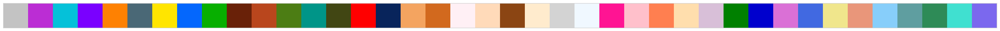

In [23]:
# Just color scheme inicialization

n_components = 40

# code from Waulter's library, to have the similar colors as in barplot
colors_order = ['#FFE500', '#FE8102', '#FF0000', '#07AF00', '#4C7D14', '#414613', '#05C1D9', '#0467FD', '#009588', '#BB2DD4', '#7A00FF', '#4A6876', '#08245B', '#B9461D', '#692108', '#C3C3C3']
neworder = np.array([16,10,7,11,2,12,1,8,4,15,14,5,9,6,3,13]).astype(int) - 1
colors_order = list(np.array(colors_order)[neworder])

if (n_components>len(colors_order)):
    colornames = np.sort(list(mcolors.CSS4_COLORS.keys()))
    count = len(colors_order)
    np.random.seed(10)
    myrandint = np.random.randint(len(colornames))
    while (count < n_components):
        myrandint =    np.random.randint(len(colornames))
        newcolor = colornames[myrandint]
        trialcount = 0
        while ((newcolor in colors_order) and (trialcount < 100)):
            newcolor = colornames[np.random.randint(0,len(colornames))]
            trialcount+=1
        #print('new color ',count,newcolor)
        colors_order.append(newcolor)
        count+=1

# just for checking colors
fig, ax = plt.subplots(figsize=(len(colors_order), 1))

# Draw a rectangle for each color in the list
for i, color in enumerate(colors_order):
    rect = plt.Rectangle((i, 0), 1, 1, facecolor=color, edgecolor='none')
    ax.add_patch(rect)

# Customize the plot
ax.set_xlim(0, len(colors_order))
ax.set_ylim(0, 1)
ax.set_xticks([])
ax.set_yticks([])
ax.set_aspect('equal')

plt.show()

METHOD:  weighted  N_components:  16
(2902, 16) (16, 3417684) matrixes loaded for n_components 16


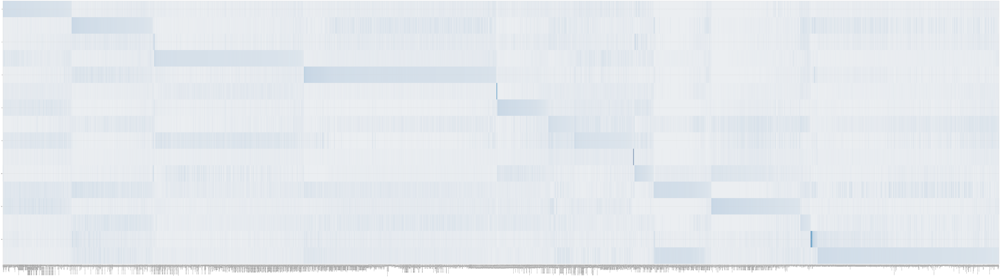

<Figure size 640x480 with 0 Axes>

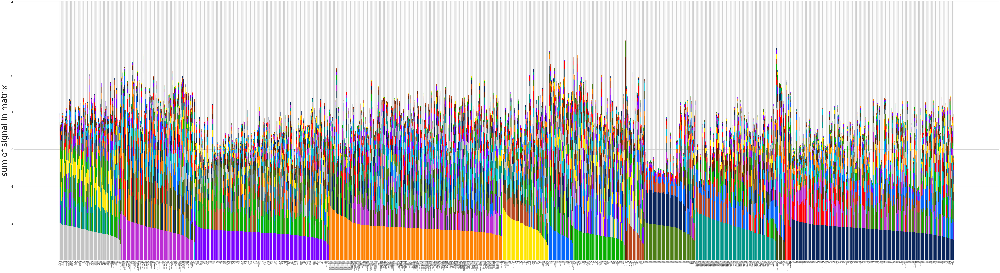

<Figure size 640x480 with 0 Axes>

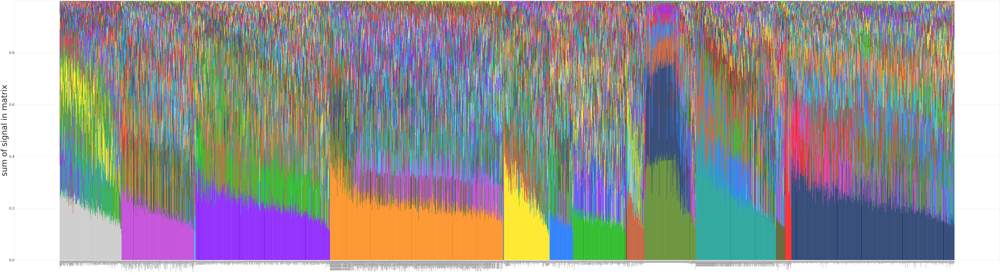

<Figure size 640x480 with 0 Axes>

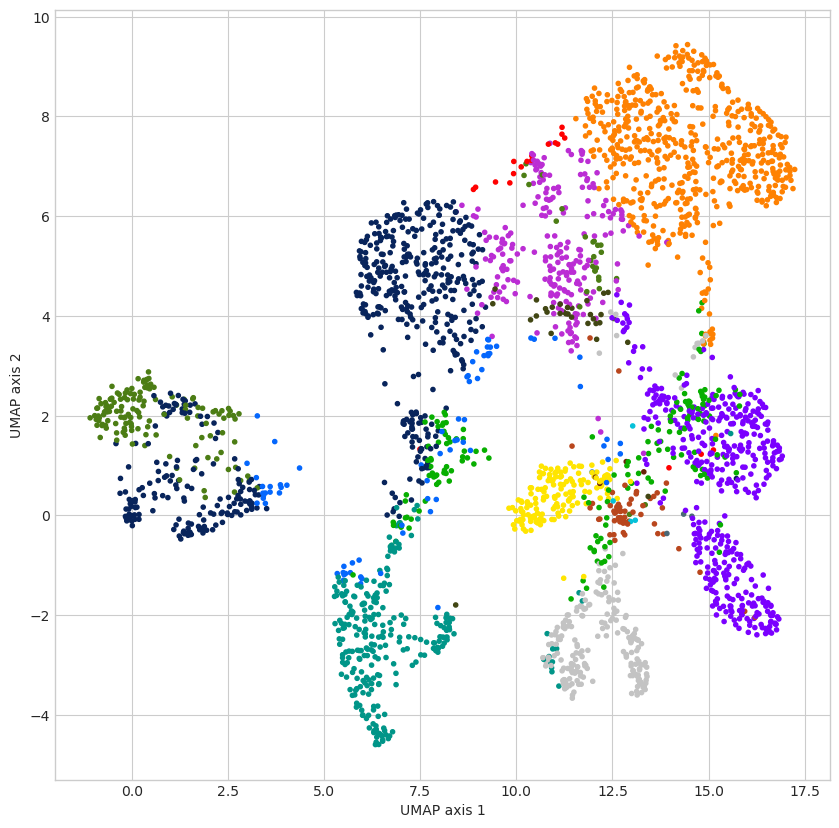

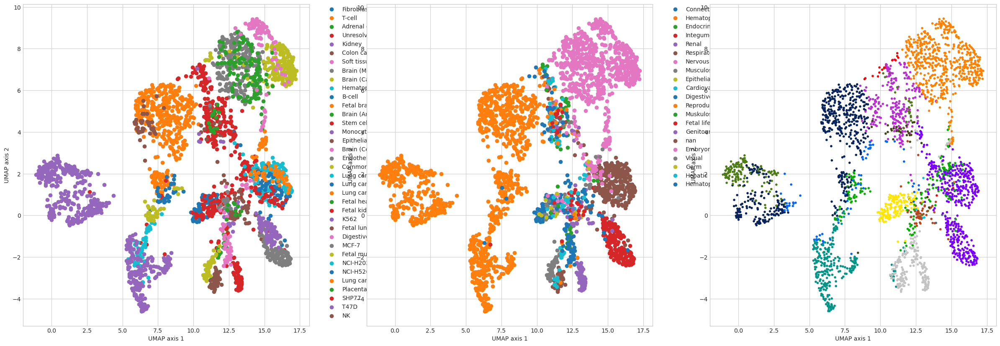

Number of samples in this category  201
Number of samples in this category  236
Number of samples in this category  4
Number of samples in this category  436
Number of samples in this category  561
Number of samples in this category  3
Number of samples in this category  148
Number of samples in this category  76
Number of samples in this category  171
Number of samples in this category  4
Number of samples in this category  56
Number of samples in this category  168
Number of samples in this category  259
Number of samples in this category  30
Number of samples in this category  20
Number of samples in this category  529


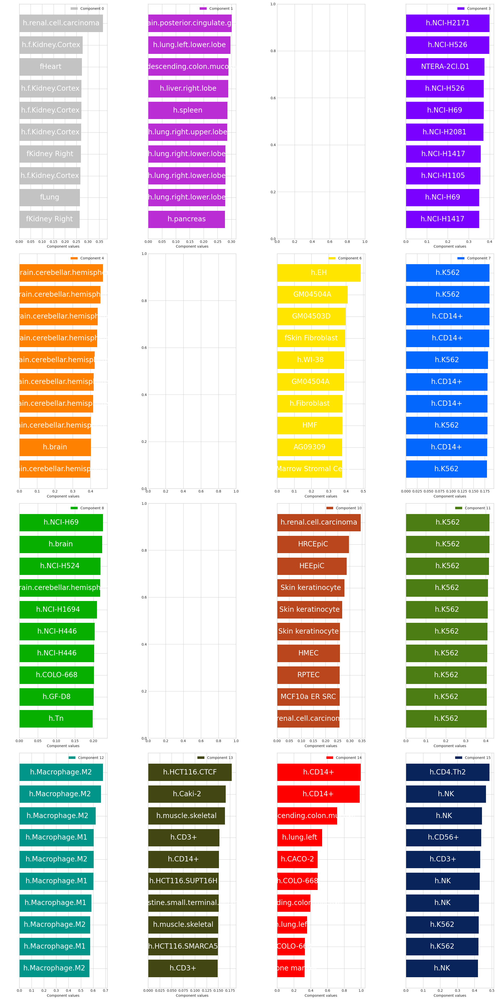

METHOD:  weighted  N_components:  24
(2902, 24) (24, 3417684) matrixes loaded for n_components 24


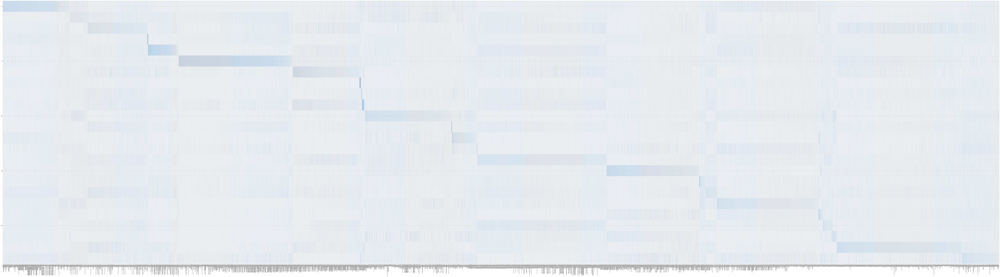

new color  16 sandybrown
new color  17 chocolate
new color  18 lavenderblush
new color  19 peachpuff
new color  20 saddlebrown
what am i doing here
new color  21 blanchedalmond
new color  22 lightgrey
new color  23 aliceblue


<Figure size 640x480 with 0 Axes>

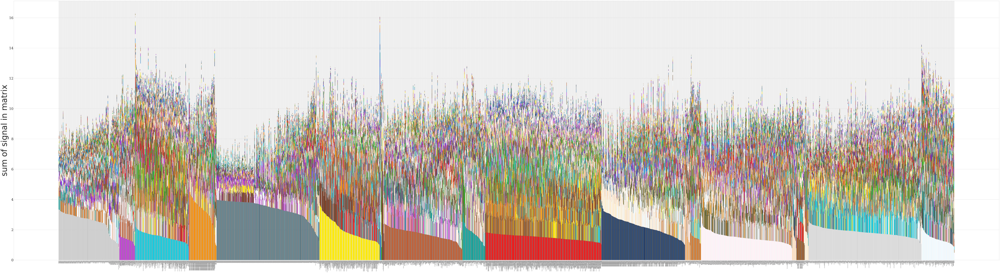

new color  16 sandybrown
new color  17 chocolate
new color  18 lavenderblush
new color  19 peachpuff
new color  20 saddlebrown
what am i doing here
new color  21 blanchedalmond
new color  22 lightgrey
new color  23 aliceblue


<Figure size 640x480 with 0 Axes>

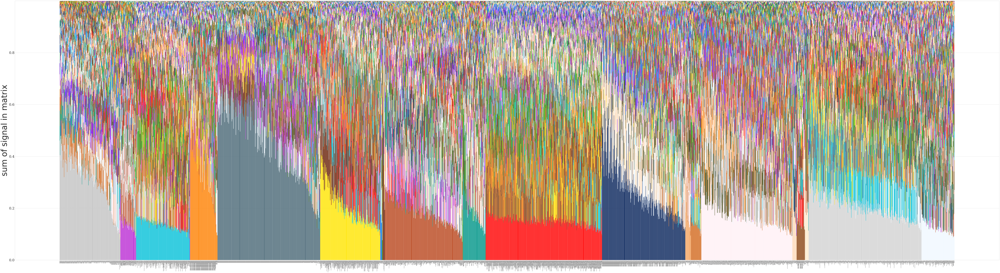

new color  16 sandybrown
new color  17 chocolate
new color  18 lavenderblush
new color  19 peachpuff
new color  20 saddlebrown
what am i doing here
new color  21 blanchedalmond
new color  22 lightgrey
new color  23 aliceblue


<Figure size 640x480 with 0 Axes>

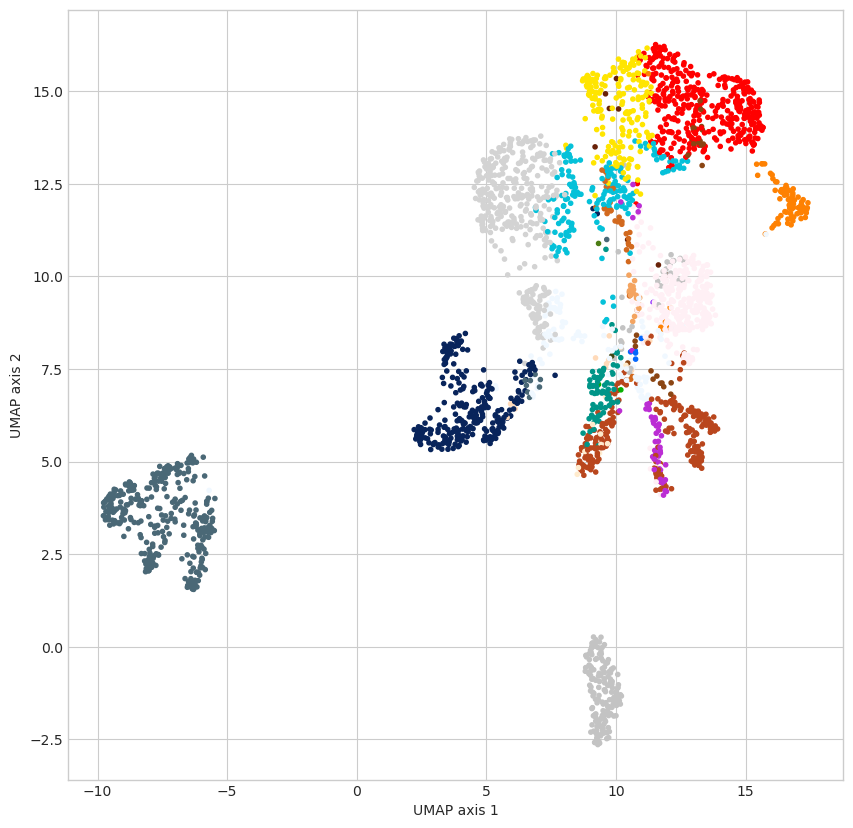

new color  16 sandybrown
new color  17 chocolate
new color  18 lavenderblush
new color  19 peachpuff
new color  20 saddlebrown
what am i doing here
new color  21 blanchedalmond
new color  22 lightgrey
new color  23 aliceblue


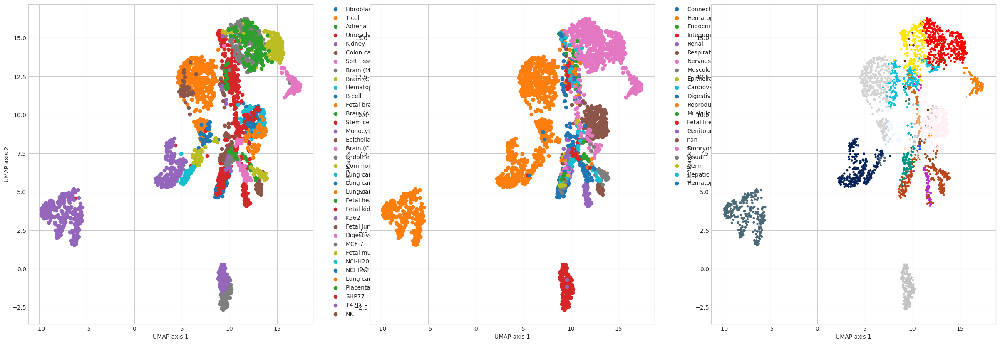

Number of samples in this category  197
Number of samples in this category  51
Number of samples in this category  174
Number of samples in this category  1
Number of samples in this category  89
Number of samples in this category  333
Number of samples in this category  195
Number of samples in this category  5
Number of samples in this category  2
Number of samples in this category  8
Number of samples in this category  252
Number of samples in this category  1
Number of samples in this category  73
Number of samples in this category  1
Number of samples in this category  377
Number of samples in this category  270
Number of samples in this category  18
Number of samples in this category  34
Number of samples in this category  295
Number of samples in this category  14
Number of samples in this category  27
Number of samples in this category  12
Number of samples in this category  366
Number of samples in this category  107


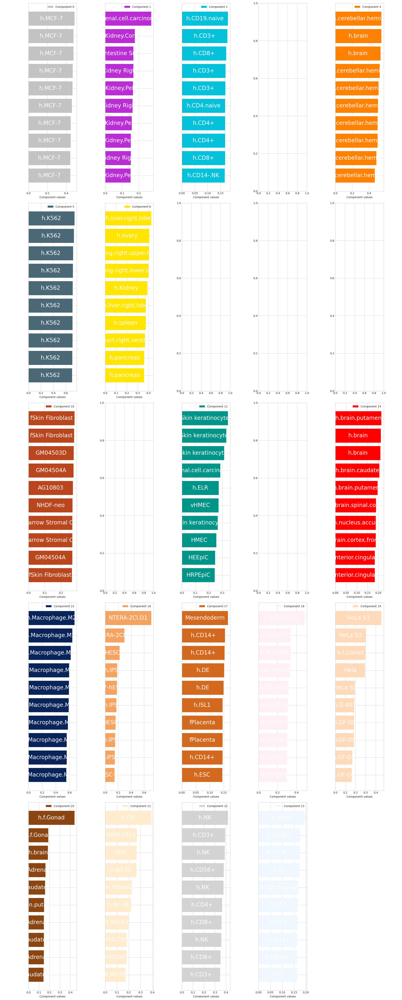

METHOD:  weighted  N_components:  36
(2902, 36) (36, 3417684) matrixes loaded for n_components 36


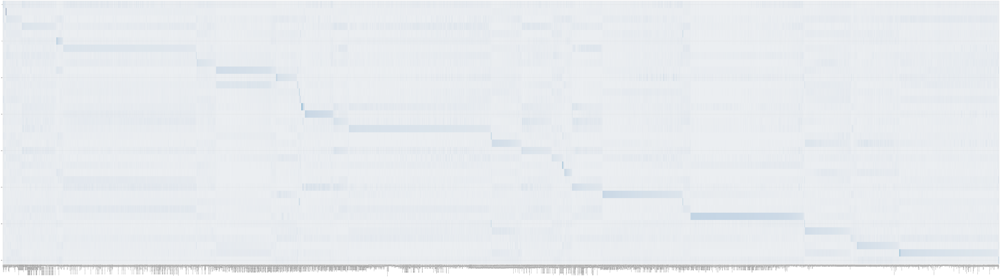

new color  16 sandybrown
new color  17 chocolate
new color  18 lavenderblush
new color  19 peachpuff
new color  20 saddlebrown
what am i doing here
new color  21 blanchedalmond
new color  22 lightgrey
new color  23 aliceblue
new color  24 deeppink
new color  25 pink
new color  26 coral
new color  27 navajowhite
new color  28 thistle
new color  29 green
new color  30 mediumblue
new color  31 orchid
new color  32 royalblue
new color  33 khaki
new color  34 darksalmon
what am i doing here
what am i doing here
new color  35 lightskyblue


<Figure size 640x480 with 0 Axes>

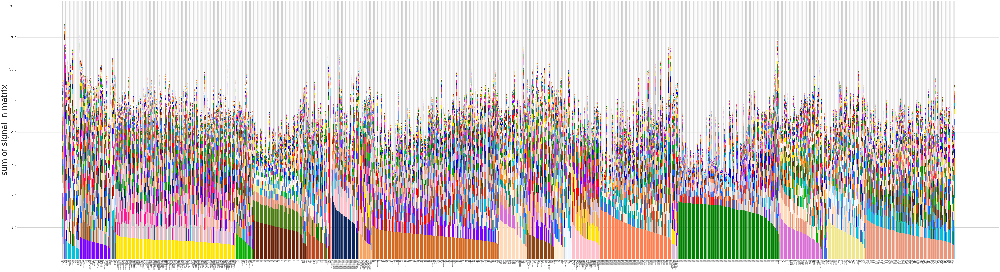

new color  16 sandybrown
new color  17 chocolate
new color  18 lavenderblush
new color  19 peachpuff
new color  20 saddlebrown
what am i doing here
new color  21 blanchedalmond
new color  22 lightgrey
new color  23 aliceblue
new color  24 deeppink
new color  25 pink
new color  26 coral
new color  27 navajowhite
new color  28 thistle
new color  29 green
new color  30 mediumblue
new color  31 orchid
new color  32 royalblue
new color  33 khaki
new color  34 darksalmon
what am i doing here
what am i doing here
new color  35 lightskyblue


<Figure size 640x480 with 0 Axes>

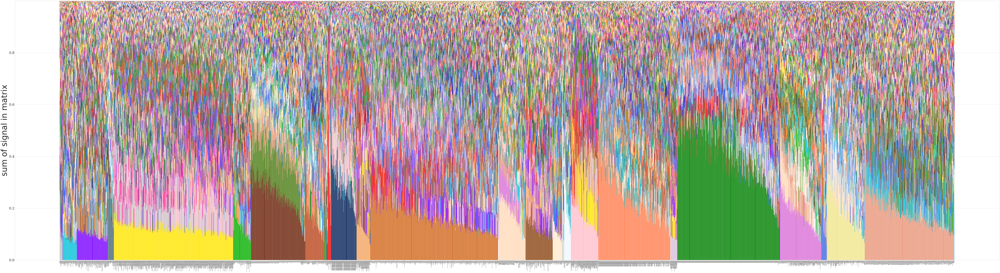

new color  16 sandybrown
new color  17 chocolate
new color  18 lavenderblush
new color  19 peachpuff
new color  20 saddlebrown
what am i doing here
new color  21 blanchedalmond
new color  22 lightgrey
new color  23 aliceblue
new color  24 deeppink
new color  25 pink
new color  26 coral
new color  27 navajowhite
new color  28 thistle
new color  29 green
new color  30 mediumblue
new color  31 orchid
new color  32 royalblue
new color  33 khaki
new color  34 darksalmon
what am i doing here
what am i doing here
new color  35 lightskyblue


<Figure size 640x480 with 0 Axes>

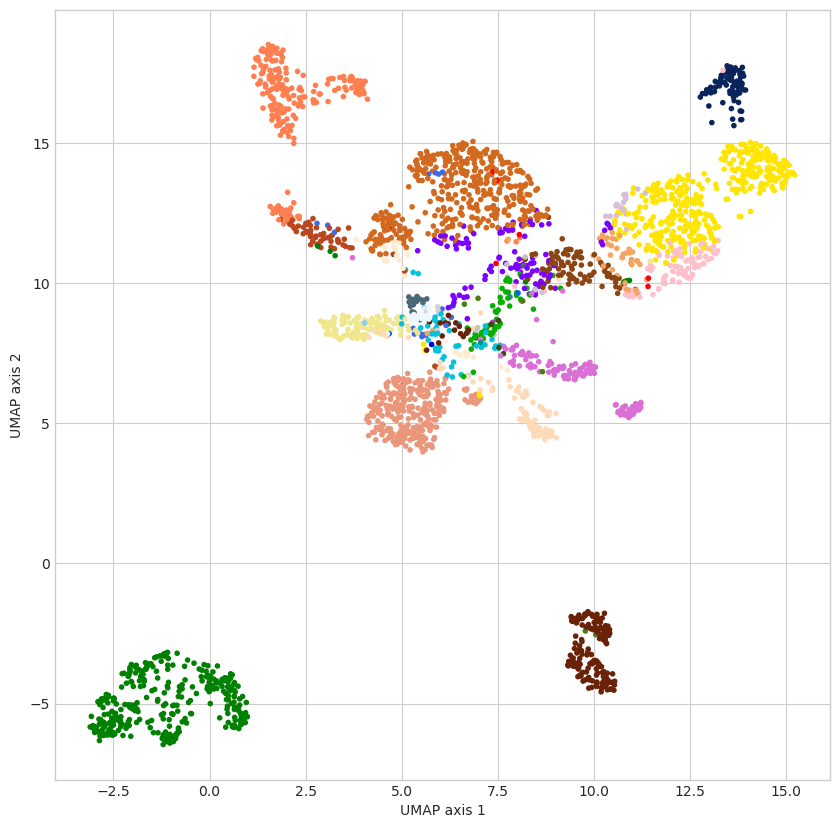

new color  16 sandybrown
new color  17 chocolate
new color  18 lavenderblush
new color  19 peachpuff
new color  20 saddlebrown
what am i doing here
new color  21 blanchedalmond
new color  22 lightgrey
new color  23 aliceblue
new color  24 deeppink
new color  25 pink
new color  26 coral
new color  27 navajowhite
new color  28 thistle
new color  29 green
new color  30 mediumblue
new color  31 orchid
new color  32 royalblue
new color  33 khaki
new color  34 darksalmon
what am i doing here
what am i doing here
new color  35 lightskyblue


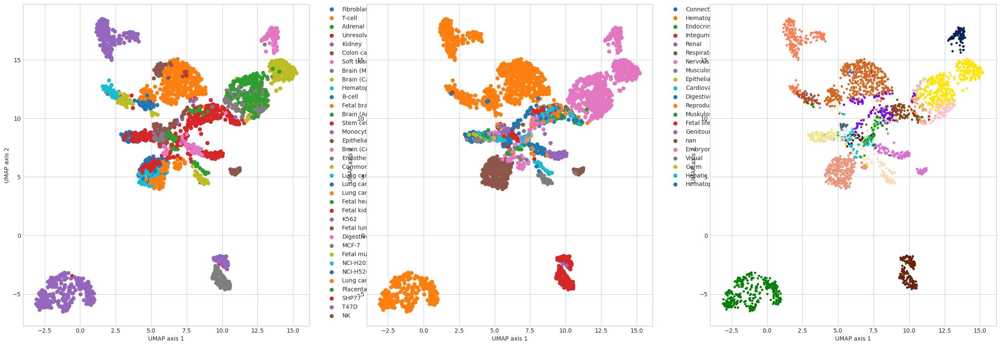

Number of samples in this category  9
Number of samples in this category  1
Number of samples in this category  46
Number of samples in this category  100
Number of samples in this category  0
Number of samples in this category  20
Number of samples in this category  387
Number of samples in this category  2
Number of samples in this category  56
Number of samples in this category  175
Number of samples in this category  61
Number of samples in this category  6
Number of samples in this category  2
Number of samples in this category  5
Number of samples in this category  10
Number of samples in this category  83
Number of samples in this category  45
Number of samples in this category  414
Number of samples in this category  3
Number of samples in this category  86
Number of samples in this category  88
Number of samples in this category  30
Number of samples in this category  7
Number of samples in this category  22
Number of samples in this category  0
Number of samples in this categ

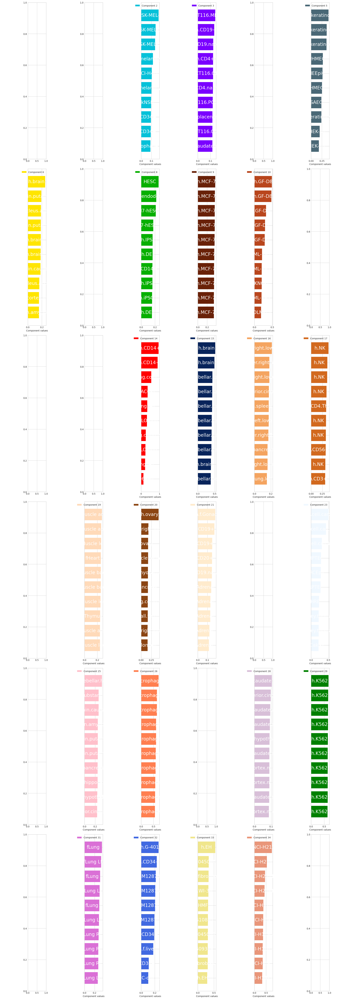

In [44]:
methods_range = ["weighted"]#["unweighted", "weighted"]
NC_ar = [16,24,36]
data_slice_size = "full"

dir_path_pic = dir_path + "Pictures/"
if not os.path.exists(dir_path_pic):
    os.makedirs(dir_path_pic)

for method in methods_range:
    for n_components in NC_ar:
        print("METHOD: ", method, " N_components: ", n_components)
        
        # Data loading
        decomp = OONMF.NMFobject(n_components)
        decomp.matrix_input_name(dir_path_mat + method +str(data_slice_size)+'.'+str(n_components)+'.W_matrix.npy', 
                                 dir_path_mat + method +str(data_slice_size)+'.'+str(n_components)+'.H_matrix.npy')
        decomp.read_matrix_input(compressed=False)
        print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)
        
        bar_graph_sort_order = get_barsortorder(decomp.Basis)
        decomp.normalize_matrices()
        
        # heatmap
        decomp.make_standard_heatmap_plot(decomp.Basis.shape[0], 
                                  decomp.Basis, 
                                  dir_path_pic+str(method)+'.'+str(data_slice_size)+'.'+str(n_components)+'.heatmap.svg', 
                                  names=np.array(allnames), 
                                  barsortorder= bar_graph_sort_order)
        
        # Stacked barplot
        decomp.make_stacked_bar_plot_sorted(decomp.Basis.shape[0], 
                         decomp.Basis.T, 
                         dir_path_pic+str(method)+'.'+str(data_slice_size)+'.'+str(n_components)+'.stacked_bar_plot.svg', 
                         names=np.array(allnames), 
                         barsortorder=bar_graph_sort_order)

        # Normolized stcked barplot
        decomp.make_stacked_bar_plot_sorted(decomp.Basis.shape[0], 
                             decomp.NormedBasis.T, 
                             dir_path_pic+str(method)+'.'+str(data_slice_size)+'.'+str(n_components)+'.stacked_bar_plot.normed.sorted.svg', 
                             names=np.array(allnames), 
                             barsortorder=bar_graph_sort_order)
        
        
        # UPAP 
        majcomp = np.argmax(decomp.Basis, axis=1)
        majcomp_no1 = np.argmax(decomp.Basis[:,1:], axis=1)+1
        
        reducer = umap.UMAP(min_dist=0.5, n_neighbors=200, random_state=20)
        embedding = reducer.fit_transform(decomp.Basis)

        plt.clf()
        plt.figure(figsize=(10,10))
        decomp.define_colors()
        plt.scatter(embedding[:,0], embedding[:,1], color=np.array(decomp.Comp_colors)[majcomp], alpha=1, marker='.')
        plt.ylabel('UMAP axis 2')
        plt.xlabel('UMAP axis 1')
        plt.savefig(dir_path_pic+str(method)+'.'+str(data_slice_size)+'.'+str(n_components)+'.umap.png', )
        plt.show()
        
        # UPAP, comparing with VA and meta
        color_columns = ['VA_cluster', 'system']
        fig, axes = plt.subplots(1, 3, figsize=(30, 10))
        for idx, color_column in enumerate(color_columns):
            cluster_colors = sns.color_palette("tab10", len(metadata[color_column].unique()))
            color_dict = dict(zip(metadata[color_column].unique(), cluster_colors))
            metadata['cluster_color'] = metadata[color_column].map(color_dict)
            ax = axes[idx]
            for cluster, color in color_dict.items():
                mask = metadata[color_column] == cluster
                ax.scatter(embedding[mask, 0], embedding[mask, 1], color=color, label=cluster)
            ax.set_xlabel('UMAP axis 1')
            ax.set_ylabel('UMAP axis 2')
            ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
        ax = axes[2]
        decomp.define_colors()
        ax.scatter(embedding[:, 0], embedding[:, 1], color=np.array(decomp.Comp_colors)[majcomp], alpha=1, marker='.')
        ax.set_ylabel('UMAP axis 2')
        ax.set_xlabel('UMAP axis 1')

        plt.savefig(dir_path_pic+str(method)+'.'+str(data_slice_size)+'.'+str(n_components)+'.umap.comparing.png', bbox_inches='tight')
        plt.show()

        ### Iterpretation part
        # Determine the number of rows and columns for the subplots
        nrows = int(np.ceil(np.sqrt(n_components)))
        ncols =int(np.ceil(n_components / nrows))

        # Create a figure with subplots
        fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(20, 10 * nrows))
        axes = axes.flatten()  # Flatten the axes array to easily loop through

        for i_component in range(n_components):
            # Plot i_component major
            green_cut = np.argmax(decomp.Basis, axis=1) == i_component
            print("Number of samples in this category ", len(green_cut[green_cut]))

            if len(green_cut[green_cut]) >= 10: # if not, there are too few samples to count 10% top
                # Plot top 10% of this major as described:
                colors = colors_order
                decomp_NormedBasis = decomp.NormedBasis[green_cut] 

                # Get the top 10% of samples
                #top_percentage = 0.1
                top_count = 10 #int(decomp_NormedBasis.shape[0] * top_percentage)

                # Sort the samples by the value of the i_component
                sorted_indices = np.argsort(decomp_NormedBasis[:, i_component])[-top_count:]
                sorted_matrix = decomp_NormedBasis[sorted_indices, :]
                sorted_names = np.array(allnames)[green_cut][sorted_indices]

                # Create a horizontal stacked bar plot on the subplot
                ax = axes[i_component]
                ax.barh(np.arange(top_count), sorted_matrix[:, i_component], color=colors[i_component % len(colors)], label=f'Component {i_component}')

                # Add labels to the plot
                for i, name in enumerate(sorted_names):
                    ax.text(sorted_matrix[i, i_component] / 2, i, name, ha='center', va='center', color='white', fontsize=20)

                # Customize the plot
                ax.set_yticks(np.arange(top_count))
                ax.set_yticklabels([])
                ax.legend(loc='upper right')
                ax.set_xlabel('Component values')
                #ax.set_ylabel('Top 10% samples')
                #ax.set_title(f'Horizontal bar plot for top 10% samples (Component {i_component})')

            else:
                continue

        # Remove unused subplots
        for i in range(i_component + 1, len(axes)):
            fig.delaxes(axes[i])

        # Adjust layout and show the figure
        fig.tight_layout()
        plt.savefig(dir_path_pic+str(method)+'.'+str(data_slice_size)+'.'+str(n_components)+'.iterpretation.10barplot.png', bbox_inches='tight')
        plt.show()



(2902, 16) (16, 3417684) matrixes loaded for n_components 16


<Figure size 640x480 with 0 Axes>

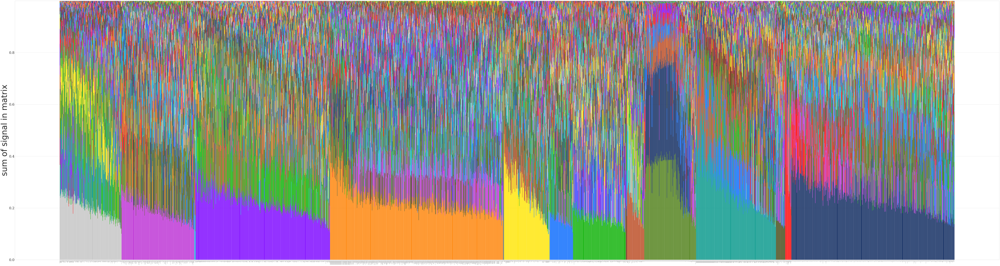

<Figure size 640x480 with 0 Axes>

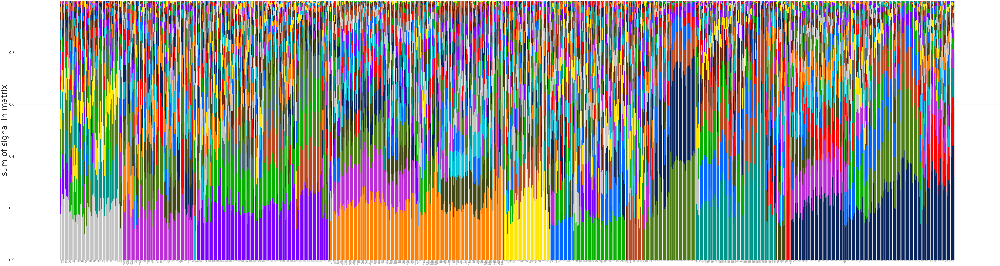

In [56]:
n_components = 16
data_slice_size = "full"
method = "weighted"

# Data loading
decomp = OONMF.NMFobject(n_components)
decomp.matrix_input_name(dir_path_mat + method +str(data_slice_size)+'.'+str(n_components)+'.W_matrix.npy', 
                         dir_path_mat + method +str(data_slice_size)+'.'+str(n_components)+'.H_matrix.npy')
decomp.read_matrix_input(compressed=False)
print(decomp.Basis.shape, decomp.Mixture.shape, "matrixes loaded for n_components", n_components)

decomp.normalize_matrices()
bar_graph_sort_order = get_barsortorder(decomp.Basis)

decomp.make_stacked_bar_plot_sorted(decomp.Basis.shape[0], 
                 decomp.NormedBasis.T, 
                 dir_path_pic+str(method)+'.'+str(data_slice_size)+'.'+str(n_components)+'.stacked_bar_plot.normed.test100.svg', 
                 names=np.array(allnames), 
                 barsortorder=bar_graph_sort_order)

new_bar_sort_order = barsortorder_all_components(decomp.Basis)

decomp.make_stacked_bar_plot_sorted(decomp.Basis.shape[0], 
                 decomp.NormedBasis.T, 
                 dir_path_pic+str(method)+'.'+str(data_slice_size)+'.'+str(n_components)+'.stacked_bar_plot.normed.test200.svg', 
                 names=np.array(allnames), 
                 barsortorder=new_bar_sort_order)
